# Cleaning

Goal: You should preprocess & clean 3 subjects yourself (which one to choose up to you) and provide/document the cleaning times / bad channels for me. As long as you document the bad components of the ICA (e.g. appendix), I see no need to send me the ICA-decomposition.

## Set-up

In [1]:
# general purpose
import numpy as np
import pandas as pd

# i/O
from scipy import io
from pathlib import Path
import datetime

# plotting
import matplotlib.pyplot as plt
import seaborn as sns

# EEG stuff
import mne
from mne_bids import (BIDSPath, read_raw_bids)

# EEG utils
import ccs_eeg_utils

import configuration

mne.set_log_level('WARNING')

I will process all three subjects at the same time, going into more detail for the first subject. The subject ids were randomly choosen.

In [2]:
print(configuration.participants)

('036', '024', '032')


These participants will get refered to later as subject x with x being the index in the above tuple, starting from 1.

In [3]:
def import_raw(subject):
    bids_path = BIDSPath(subject=subject, task="P3", session="P3",
                         datatype='eeg', suffix='eeg',
                         root=configuration.fname.bids_root)

    # read the file
    raw = read_raw_bids(bids_path)
    # fix the annotations readin
    ccs_eeg_utils.read_annotations_core(bids_path, raw)
    raw.load_data()
    return raw


raw_one = import_raw(configuration.participants[0])
raw_two = import_raw(configuration.participants[1])
raw_three = import_raw(configuration.participants[2])


/tmp/ipykernel_232500/2089698013.py:7: RuntimeWarning: Data file name in EEG.data (sub-036_task-P3_eeg.fdt) is incorrect, the file name must have changed on disk, using the correct file name (sub-036_ses-P3_task-P3_eeg.fdt).
  raw = read_raw_bids(bids_path)
/tmp/ipykernel_232500/2089698013.py:7: RuntimeWarning: participants.tsv file not found for Data/p3/sub-036/ses-P3/eeg/sub-036_ses-P3_task-P3_eeg.set
  raw = read_raw_bids(bids_path)
/tmp/ipykernel_232500/2089698013.py:7: RuntimeWarning: Data file name in EEG.data (sub-024_task-P3_eeg.fdt) is incorrect, the file name must have changed on disk, using the correct file name (sub-024_ses-P3_task-P3_eeg.fdt).
  raw = read_raw_bids(bids_path)
/tmp/ipykernel_232500/2089698013.py:7: RuntimeWarning: participants.tsv file not found for Data/p3/sub-024/ses-P3/eeg/sub-024_ses-P3_task-P3_eeg.set
  raw = read_raw_bids(bids_path)
/tmp/ipykernel_232500/2089698013.py:7: RuntimeWarning: Data file name in EEG.data (sub-032_task-P3_eeg.fdt) is incorrect

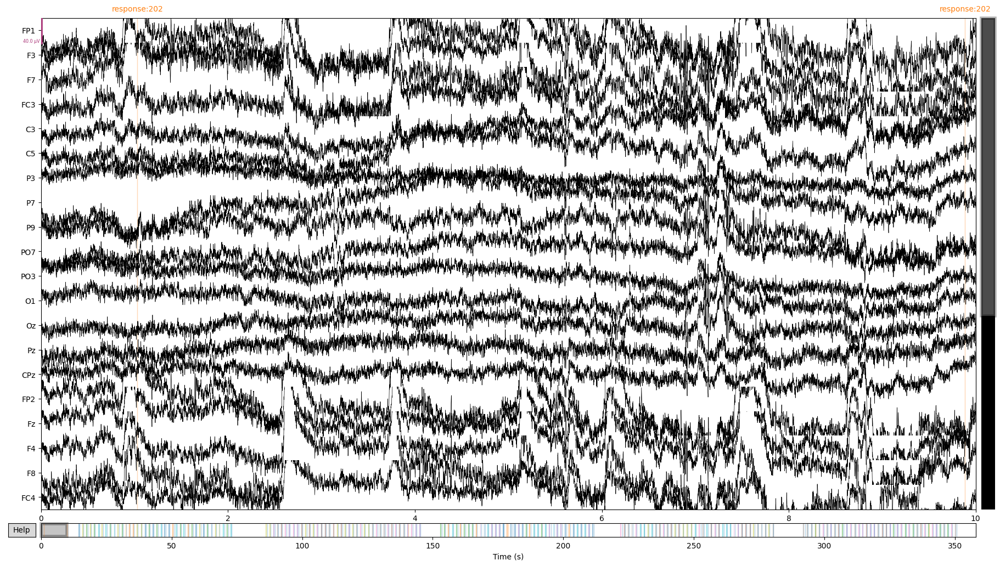

In [4]:
%matplotlib qt
raw_one.plot()

## Add channel locations

For the position of the electrodes we get from the ERP documentation:
"We recorded from 30 scalp electrodes, mounted in an elastic cap
and placed according to the International 10/20 System."

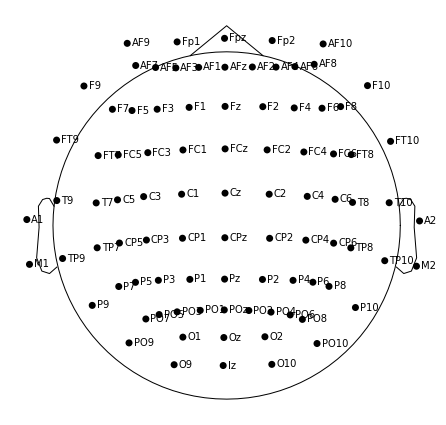

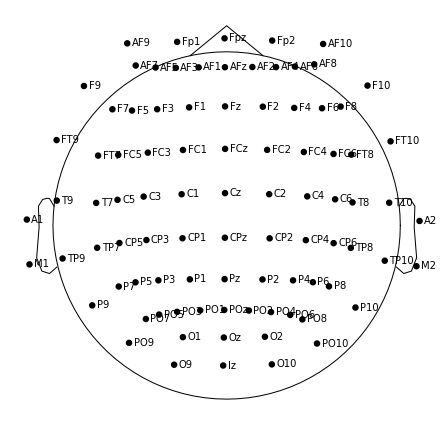

In [5]:
%matplotlib inline
raw_one.set_montage('standard_1020', match_case=False)
raw_two.set_montage('standard_1020', match_case=False)
raw_three.set_montage('standard_1020', match_case=False)
mne.channels.make_standard_montage('standard_1020').plot(kind='topomap')

In [6]:
raw_one

<RawEEGLAB | sub-036_ses-P3_task-P3_eeg.fdt, 33 x 366592 (358.0 s), ~92.3 MB, data loaded>

## Downsampling

To reduce the amount of memory needed I reduce the sampling frequency to 256 Hz.

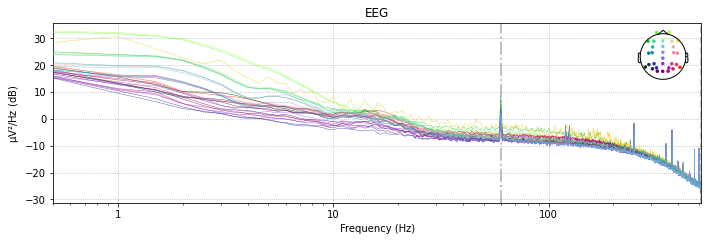

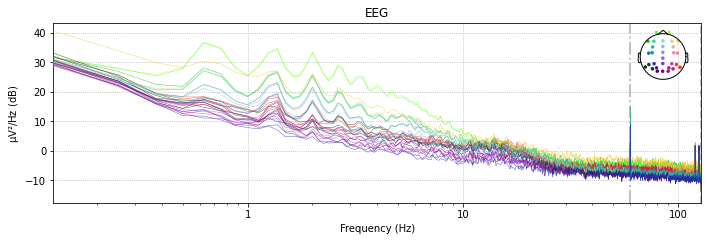

In [7]:
raw_one_downsampled = raw_one.copy().resample(sfreq=256)
raw_two_downsampled = raw_two.copy().resample(sfreq=256)
raw_three_downsampled = raw_three.copy().resample(sfreq=256)
raw_one.plot_psd(xscale='log');
raw_one_downsampled.plot_psd(xscale='log');

Notice especially for the non-downsampled signal the DC aliases at multiples of 60Hz (as the experiments were recorded in the USA). The downsampling seems to increase the energy in the low frequency fluctuations. There are now frequencies with distinctly more energy. As resample uses a low-pass filter and anti-aliasing, I suspect this being due to the now larger window size.

## Re-referencing

In the ERP core the authors recommend using the average of P9 and P10 for reference as the provided clean signals here.

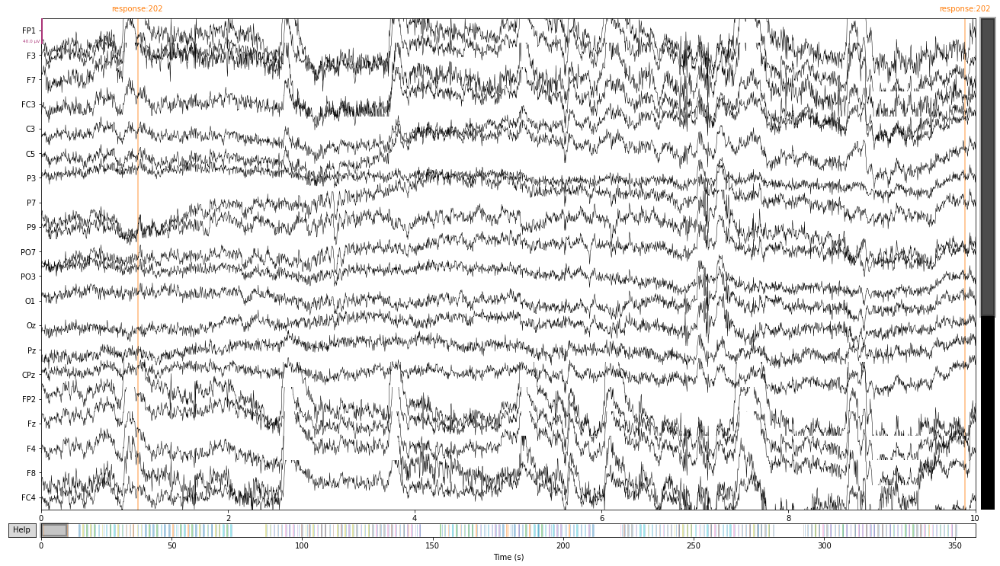

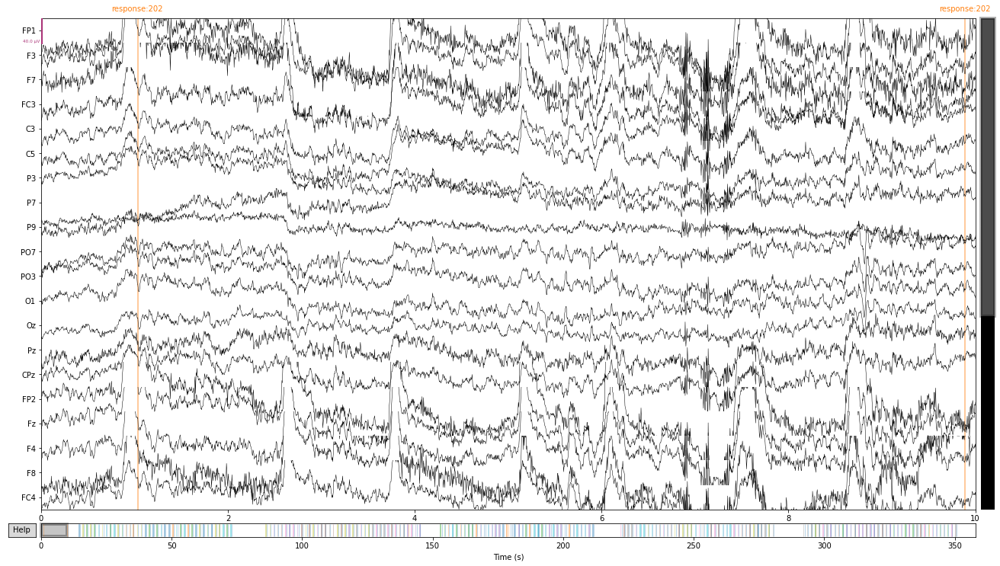

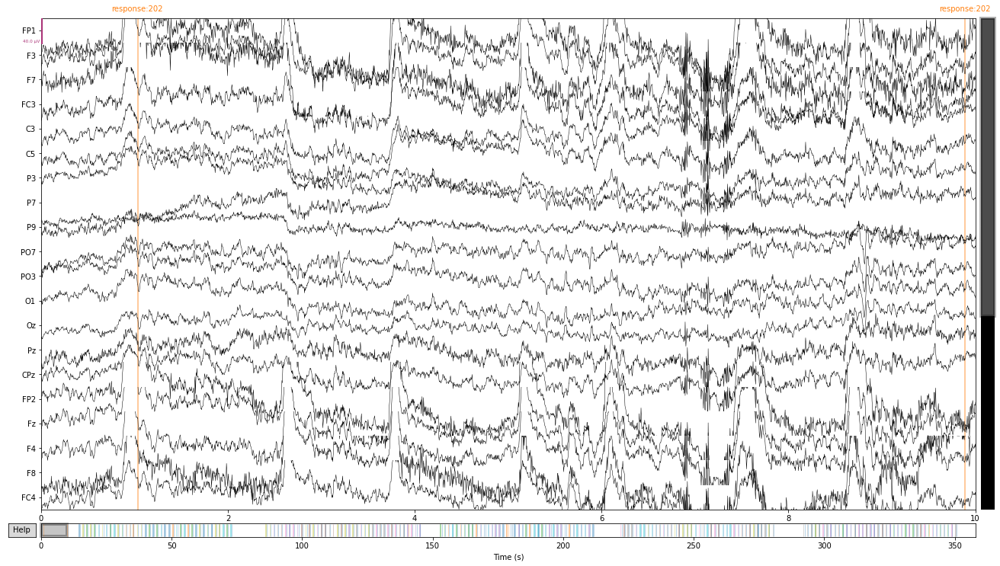

In [8]:
raw_one_downsampled_reref, ref_data = mne.set_eeg_reference(raw_one_downsampled,
                                                            ['P9', 'P10'],
                                                            copy=True)
raw_two_downsampled_reref, ref_data = mne.set_eeg_reference(raw_two_downsampled,
                                                            ['P9', 'P10'],
                                                            copy=True)
raw_three_downsampled_reref, ref_data = mne.set_eeg_reference(raw_three_downsampled,
                                                              ['P9', 'P10'],
                                                              copy=True)
raw_one_downsampled.plot()
raw_one_downsampled_reref.plot()

It is not directly obvious from the signal that the improvement is tangible.

## Filtering

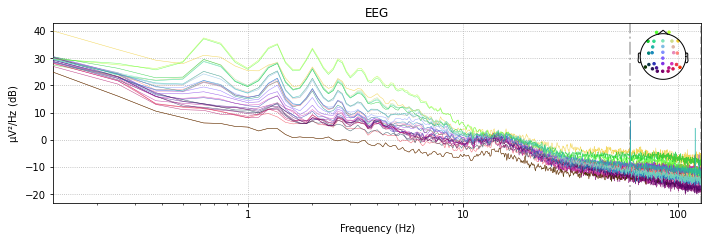

In [9]:
raw_one_downsampled_reref.plot_psd(xscale='log');

Following the best practices as described by Cheveigne et al. and Widmann et al. I apply the sharp knife that is a filter with the following steps:
* apply successively steep high-pass and a shallow low-pass filter instead of band-pass filters
* high-pass filters <0.1 Hz (Acunzo et al. (2012))
* low-pass filters with >40Hz 
* report the following filter parameters:
   1. filter type
   2. cutoff frequency and definition used
   3. filter order
   4. roll-off or transition bandwidth
   5. passband ripple and stopband attenuation
   6. filter delay and causality
   7. direction of computation
* show the impulse response
* ringing filter effects occur at discontinouities
* explore the difference between the filtered and unfiltered data of the filters with onset and peak latencies and peak amplitues

I chose the high pass cutoff to be as high as can be justified as it is important to remove the visible slow drifts. Furthermore, we saw previously that the low frequencies have a high energy here. For the low pass filter I first tried 50Hz, but found it to not fully remove the DC artifacts. So I settled on 45Hz.

In [10]:
filtered_one_high = raw_one_downsampled_reref.copy().filter(l_freq=configuration.high_pass_cutoff_freq,
                                                            h_freq=None,
                                                            fir_design='firwin',
                                                            verbose=True)
filtered_one_both = filtered_one_high.copy().filter(l_freq=None,
                                                    h_freq=configuration.low_pass_cutoff_freq,
                                                    fir_design='firwin',
                                                    verbose=True)

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Filter length: 8449 samples (33.004 sec)

Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 77 samples (0.301 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished


Conveniently, the filter already outputs their most important parameters. It is important to note here that acausal filters are applied. For acausal filters, the future can cause the past which may lead to a wrong onset. "the signal in the smoothed zero-phase filter output might already deviate from baseline before signal onset in the input, possibly systematically underestimating onset latencies after low-pass filtering (...)" (Widmann et al. 2015)

We also have to be careful cleaning the data. Filtering across the artefacts such as spikes and jumps present in the signal leads to ringing. I should consider in the future also cleaning such artifacts before filtering.

To investigate the effects of the filtering we look at the psd:

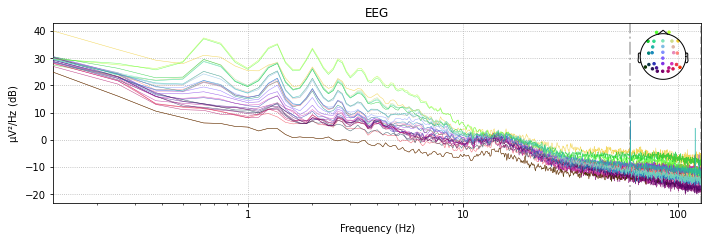

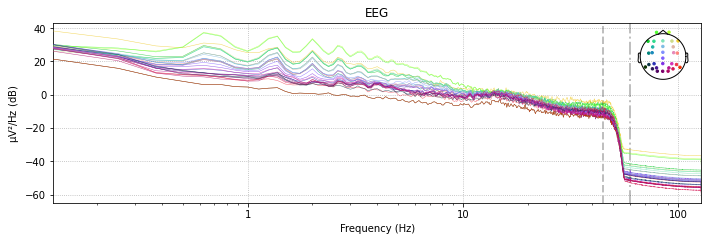

In [11]:
raw_one_downsampled_reref.plot_psd(xscale='log');
filtered_one_both.plot_psd(xscale='log');

I'm underwhelmed by the performance of the high-pass filter as the energy in the low frequencies seems to stay about the same. Yet, after reading the strongly cautious filter papers referenced I accept this tradeoff. As intended, the power line artifact is gone and the high frequency fluctuations are strongly hemmed. Let's also visualize the inner working on a part of the signal. I have chosen the signal in the range from 98s till 99s as there is a stimulus and a correct reaction. Here we should see a good performance.

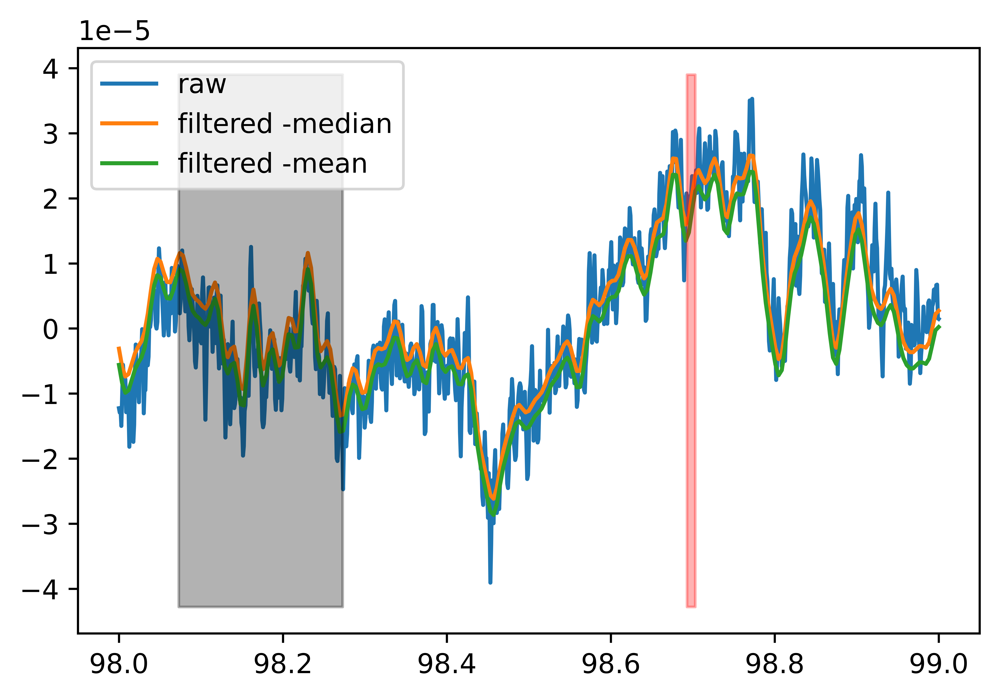

In [12]:
%matplotlib inline
start_s = 98
end_s = 99

raw_ = raw_one.copy()
filtered_both_ = filtered_one_both.copy()

# make sure they use the same reference
raw_.set_eeg_reference(ref_channels=['P9', 'P10'])
filtered_both_.set_eeg_reference(ref_channels=['P9', 'P10'])


raw_ = raw_.pick_channels(["Pz"])
filtered_both_ = filtered_both_.pick_channels(["Pz"])

raw_.crop(tmin=start_s, tmax=end_s)
filtered_both_.crop(tmin=start_s, tmax=end_s)

sampling_freq = 1024
time_old = np.arange(start_s,
                     end_s + (1/sampling_freq), # because cropping vs range
                     (1/sampling_freq))
time = np.arange(start_s,
                 end_s + (1/configuration.resampling_freq),
                 (1/configuration.resampling_freq))

fig, ax = plt.subplots(dpi=1200)
ax.plot(time_old, raw_.get_data().T-np.median(raw_.get_data().T),
        label='raw')
ax.plot(time, filtered_both_.get_data().T-np.median(filtered_both_.get_data().T),
        label='filtered -median')
ax.plot(time, filtered_both_.get_data().T-np.mean(filtered_both_.get_data().T),
        label='filtered -mean')
ax.legend()

x_lim = ax.get_ylim()  # else the axis would blow up
annos_idx = np.intersect1d(np.where(filtered_both_.annotations.onset > start_s + configuration.monitor_delay), 
                           np.where(filtered_both_.annotations.onset < end_s + configuration.monitor_delay))
for i in annos_idx:
    annotation = filtered_both_.annotations[i]
    annotation['onset'] = annotation['onset'] + configuration.monitor_delay
    if 'response' in annotation['description']:
        ax.fill_betweenx(x_lim,
                         annotation['onset'],
                         (annotation['onset']+0.01),
                         alpha=0.3,
                         zorder=4,
                         color='r')
    elif 'stimulus' in annotation['description']:
        ax.fill_betweenx(x_lim,
                         annotation['onset'],
                         (annotation['onset']+annotation['duration']),
                         alpha=0.3,
                         zorder=4,
                         color='k')

There are still some fluctuations in the data, but all in all the filter seem to preserve the relevant features of the raw data while smoothing in. 

For this plot special care had to be taken to correct for the monitor delay.

### other subjects

Now we can apply those filters also to the other two subjects and check the results:

In [13]:
# no 2
filtered_two_high = raw_two_downsampled_reref.copy().filter(l_freq=configuration.high_pass_cutoff_freq,
                                                            h_freq=None,
                                                            fir_design='firwin',
                                                            verbose=True)
filtered_two_both = filtered_two_high.copy().filter(l_freq=None,
                                                    h_freq=configuration.low_pass_cutoff_freq,
                                                    fir_design='firwin',
                                                    verbose=True)

# no 3
filtered_three_high = raw_three_downsampled_reref.copy().filter(l_freq=configuration.high_pass_cutoff_freq,
                                                                h_freq=None,
                                                                fir_design='firwin',
                                                                verbose=True)
filtered_three_both = filtered_three_high.copy().filter(l_freq=None,
                                                        h_freq=configuration.low_pass_cutoff_freq,
                                                        fir_design='firwin',
                                                        verbose=True)

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Filter length: 8449 samples (33.004 sec)

Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 77 samples (0.301 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Filter length: 8449 samples (33.004 sec)

Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 77 samples (0.301 sec)



[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.

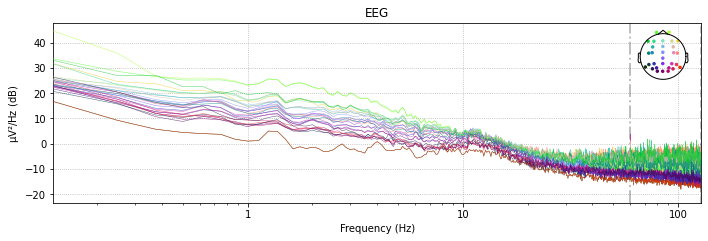

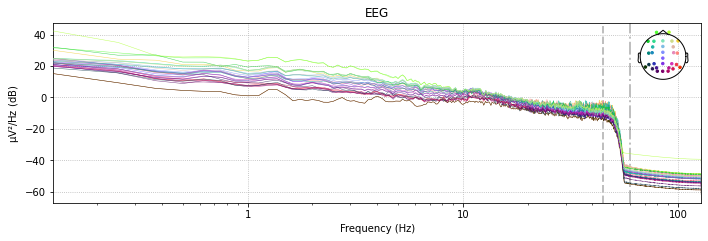

<RawEEGLAB | sub-024_ses-P3_task-P3_eeg.fdt, 33 x 91904 (359.0 s), ~23.2 MB, data loaded>

In [14]:
%matplotlib inline
# check results for no 2
raw_two_downsampled_reref.plot_psd(xscale='log');
filtered_two_both.plot_psd(xscale='log');

filtered_two_both

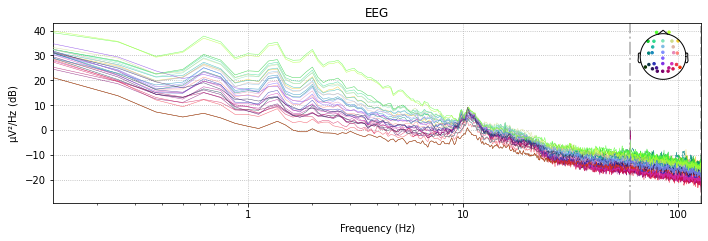

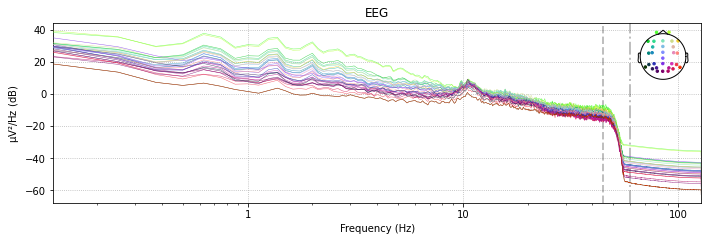

<RawEEGLAB | sub-032_ses-P3_task-P3_eeg.fdt, 33 x 94720 (370.0 s), ~23.9 MB, data loaded>

In [15]:
# check results for no 3
raw_three_downsampled_reref.plot_psd(xscale='log');
filtered_three_both.plot_psd(xscale='log');

filtered_three_both

It all works as expected.

## ICA

The mne documentation recommends using a seed to control the randomness and make the ICA reproduceable. I will furthermore follow the analysis procedure by the authors of ERP core and save the pictures of the ICA components and especially the rejected ICA components to the results directory.

The `fastica` method did not converge, thus I opted to use the newer, faster and more robust method `picard`. This method did converge quiet fast.

In [16]:
import picard
from picard import picard

In [17]:
ica_one = mne.preprocessing.ICA(method="picard",
                                max_iter="auto",
                                random_state=configuration.seed_ICA)
filtered_one_ica = filtered_one_both.copy().filter(l_freq=1,
                                                   h_freq=None,
                                                   fir_design='firwin',
                                                   verbose=True)
ica_one.fit(filtered_one_ica, verbose=True)

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 845 samples (3.301 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.1s finished


Selecting by non-zero PCA components: 29 components
Fitting ICA took 32.9s.


Method,picard
Fit,142 iterations on raw data (91648 samples)
ICA components,29
Explained variance,100.0 %
Available PCA components,30
Channel types,eeg
ICA components marked for exclusion,—


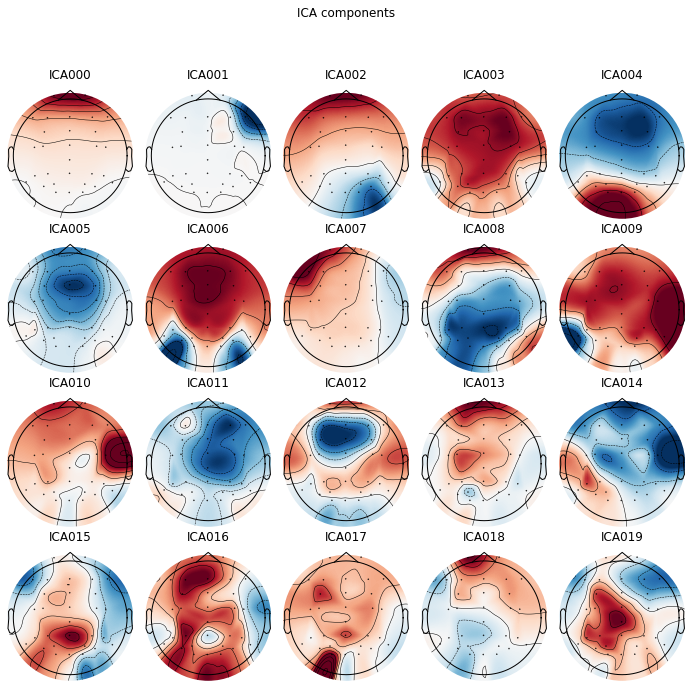

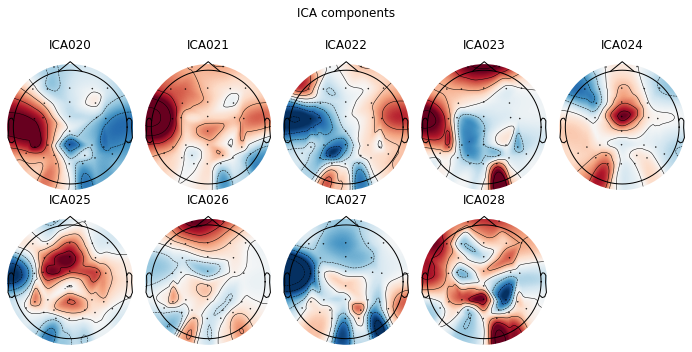

In [18]:
%matplotlib inline
components = ica_one.plot_components(show=False)
for i, component in enumerate(components):
    path_ = Path(configuration.path_ica_results /
                 f"ICA_{configuration.participants[0]}_{i}_{datetime.datetime.now().strftime('%m%d-%H%M')}.png")
    component.savefig(fname=str(path_),
                      transparent=True)
plt.show();

After consulting the ICA labeling tutorial by the UC San Diego, I plotted and went through the different ICA components and looked out for the following:
Plausible signals have a local peak at between $5 - 30\,Hz$, with $10\,Hz$ most common. The power spectrum decreases with $1/f$ Their topography looks often dipolar.
But I excluded components showing these characteristics:
1. heartbeats: 1Hz pattern (QRS complex), near linear gradient scalp topography
2. blinks: ECDs near eyes, intervals of flat activity, IRP: discharge per blink, most power resides below $5\,Hz$
3. eye movements: changes where the field points to, jump
4. muscle: power at higher frequencies (20Hz), local - outside the skull, activity only in a part of the experiment
5. noisy electrode: high line noise activation (50/60Hz) or channel noise by large and consistent artifact, focal scalp topography
6. other: anything else, looking uncharacteristic. May have a high IC number, i.e. has low explained variance

In [26]:
%matplotlib qt
ica_one.plot_properties(filtered_one_both, picks = list(range(0,29)))

/home/work/Dokumente/Studium/SimTech_MSc/14. Semester/Signal_Processing_and_Analysis_of_Human_Brain_Potentials_EEG/Ostertag_SS2022_EEGSemesterProject/venv/lib/python3.8/site-packages/mne/viz/ica.py:128: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize, facecolor=[0.95] * 3)


[<Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6

[0, 13, 18, 26, 4, 5, 25, 27, 1]


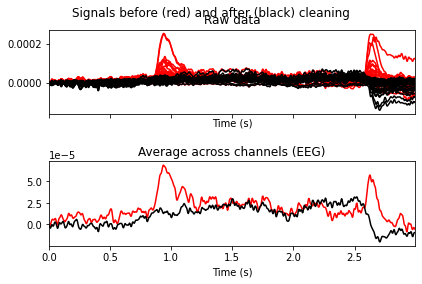

In [30]:
%matplotlib inline
# nice: 2, 3, 4, 9
exclude_heartbeat = [] # []
exclude_blink = [0]
exclude_eye = [13,18,26]
exclude_muscle = [4,5,25,27]
exclude_noisy = [1]
other = [6,14]

to_exclude = []
to_exclude.extend(exclude_blink)
to_exclude.extend(exclude_eye)
to_exclude.extend(exclude_muscle)
to_exclude.extend(exclude_heartbeat)
to_exclude.extend(exclude_noisy)
print(to_exclude)

ica_one.plot_overlay(filtered_one_both, exclude=to_exclude, picks='eeg');

Especially for the higher order ICA components I had a hard time classifing them. They have large segments of non-localized, but same-value activity.
Many of the strange and strong peaks look like they are being excluded. So it seems to do its job. I was pretty cautious not to exclude too much data as I have no long experience.

After we have checked this, we can now apply the ICA:

In [31]:
%matplotlib qt
ica_one.exclude = to_exclude
filtered_one_reconstructed = filtered_one_both.copy()
ica_one.apply(filtered_one_reconstructed)
filtered_one_reconstructed.plot();

/home/work/Dokumente/Studium/SimTech_MSc/14. Semester/Signal_Processing_and_Analysis_of_Human_Brain_Potentials_EEG/Ostertag_SS2022_EEGSemesterProject/venv/lib/python3.8/site-packages/mne/viz/ica.py:128: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize, facecolor=[0.95] * 3)


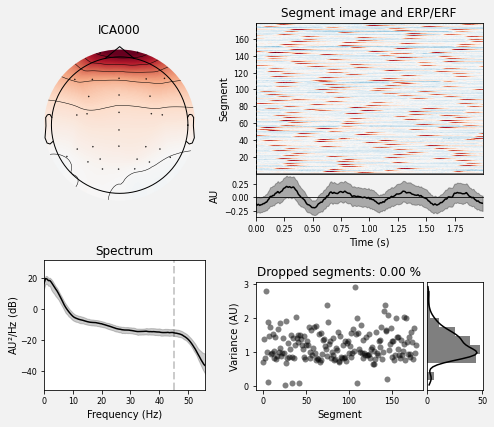

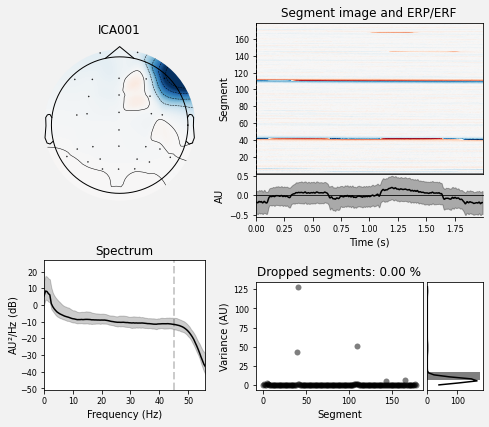

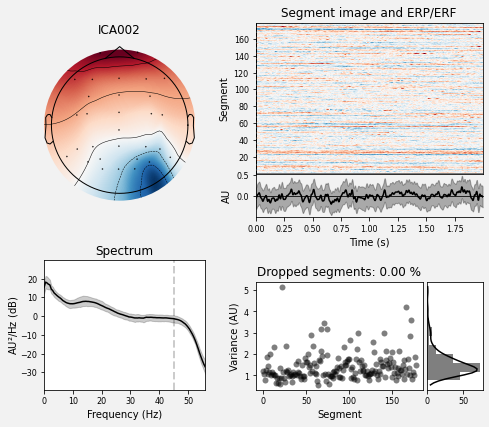

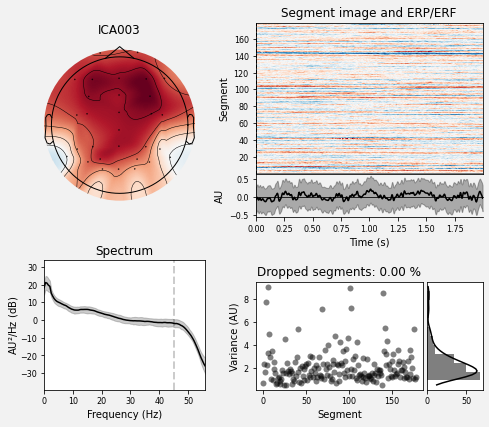

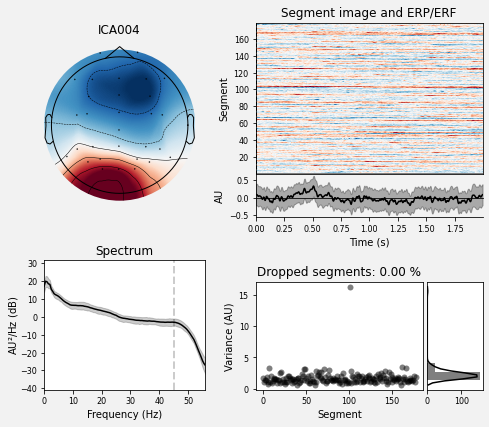

...

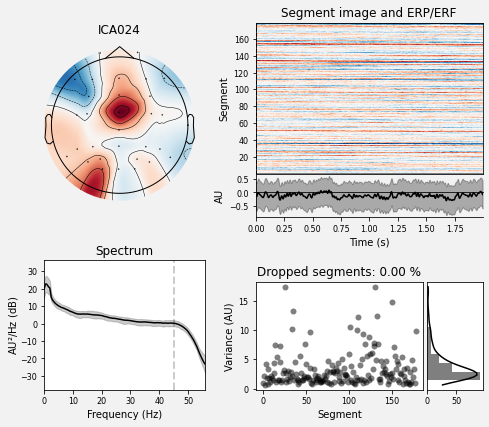

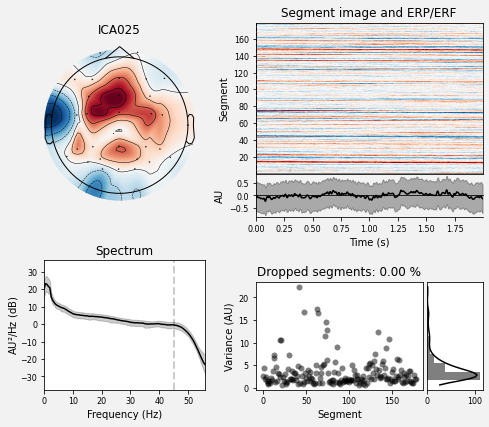

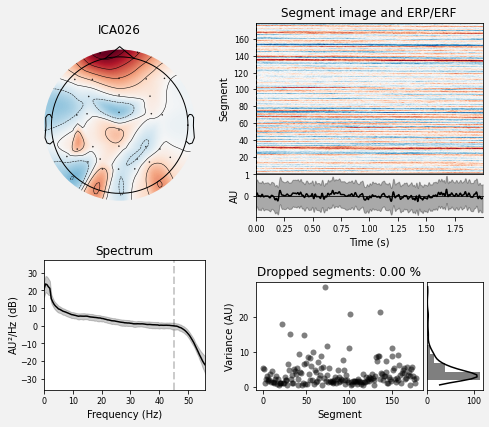

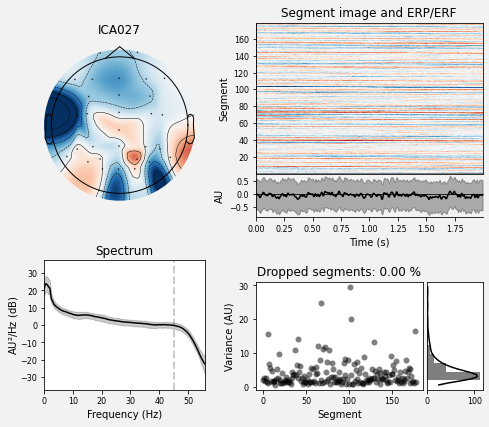

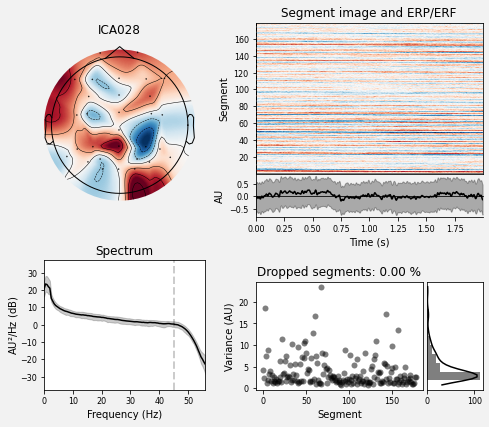

In [32]:
%matplotlib inline
excluded = ica_one.plot_properties(filtered_one_both, picks = list(range(0,29)), show=False);

time = datetime.datetime.now().strftime('%m%d-%H%M')
for i, ex in enumerate(excluded):
    if i not in to_exclude:
        continue
    kind = ''
    if i in exclude_heartbeat:
        kind = 'heartbeat'
    elif i in exclude_blink:
        kind = 'blink'
    elif i in exclude_eye:
        kind = 'eye'
    elif i in exclude_muscle:
        kind = 'muscle'
    elif i in exclude_noisy:
        kind = 'noisy_electrode'
    elif i in other:
        kind = 'other'
    else:
        print(f"This should not happen! {to_exclude[i]}")
    
    path_ = Path(configuration.path_ica_results /
                 f"ICA_{configuration.participants[0]}_ICA0{i}_{kind}_{time}.png")
    ex.savefig(fname=str(path_),
               transparent=True);

### other subjects

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 845 samples (3.301 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.1s finished


Selecting by non-zero PCA components: 29 components
Fitting ICA took 9.1s.


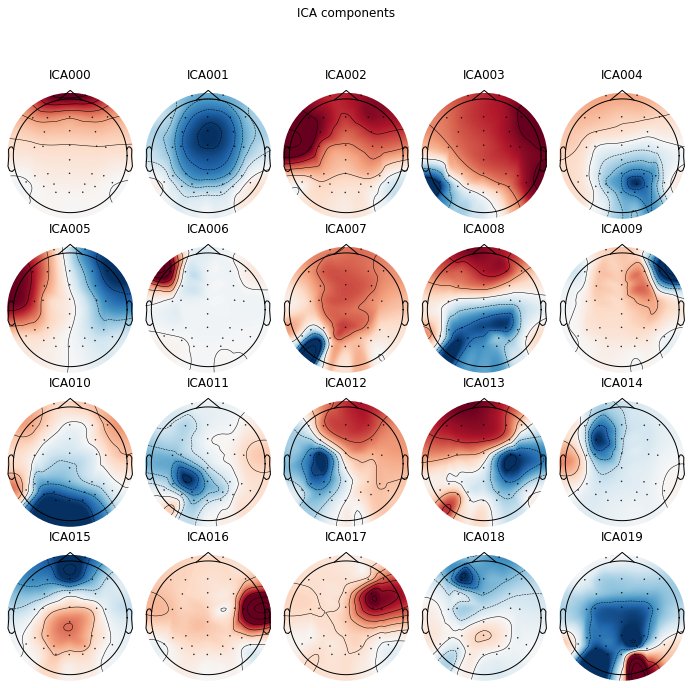

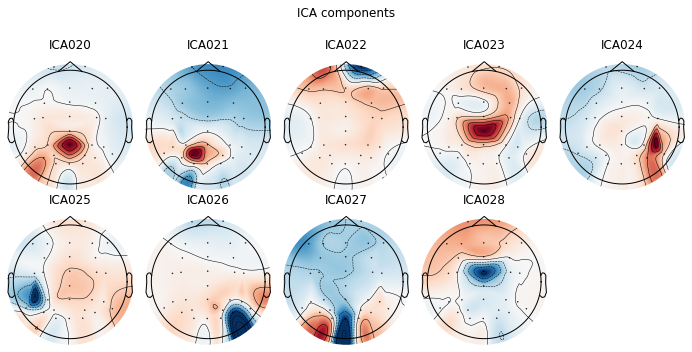

/home/work/Dokumente/Studium/SimTech_MSc/14. Semester/Signal_Processing_and_Analysis_of_Human_Brain_Potentials_EEG/Ostertag_SS2022_EEGSemesterProject/venv/lib/python3.8/site-packages/mne/viz/ica.py:128: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize, facecolor=[0.95] * 3)


[<Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6

In [33]:
# subject two
ica_two = mne.preprocessing.ICA(method="fastica",
                                max_iter="auto",
                                random_state=configuration.seed_ICA)
filtered_two_ica = filtered_two_both.copy().filter(l_freq=1,
                                                   h_freq=None,
                                                   fir_design='firwin',
                                                   verbose=True)
ica_two.fit(filtered_two_ica, verbose=True)

%matplotlib inline
components = ica_two.plot_components(show=False)
for i, component in enumerate(components):
    # to change participant
    path_ = Path(configuration.path_ica_results /
                 f"ICA_{configuration.participants[1]}_{i}_{datetime.datetime.now().strftime('%m%d-%H%M')}.png")
    component.savefig(fname=str(path_),
                      transparent=True)
plt.show()

%matplotlib qt
ica_two.plot_properties(filtered_two_both, picks = list(range(0,29)))

[0, 8, 15, 22, 3, 5, 16, 23, 24, 25, 26, 6, 9, 18, 19, 28]


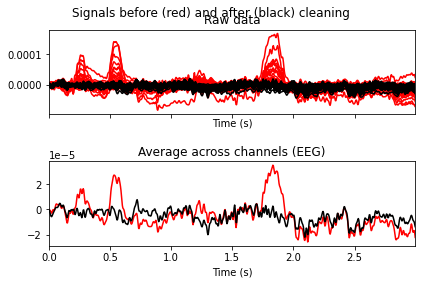

/home/work/Dokumente/Studium/SimTech_MSc/14. Semester/Signal_Processing_and_Analysis_of_Human_Brain_Potentials_EEG/Ostertag_SS2022_EEGSemesterProject/venv/lib/python3.8/site-packages/mne/viz/ica.py:128: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize, facecolor=[0.95] * 3)


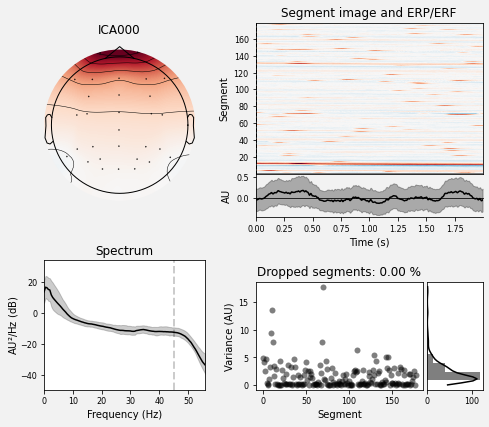

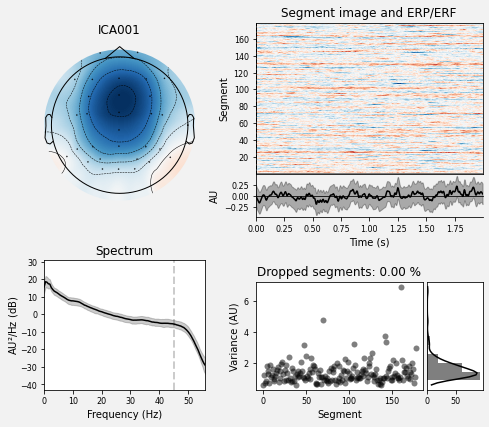

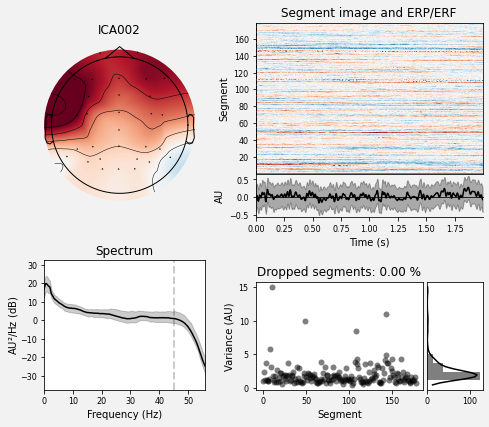

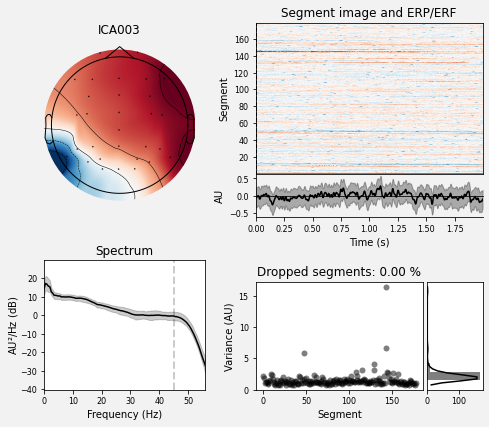

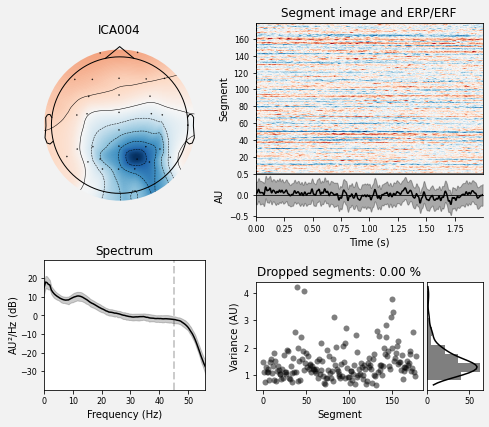

...

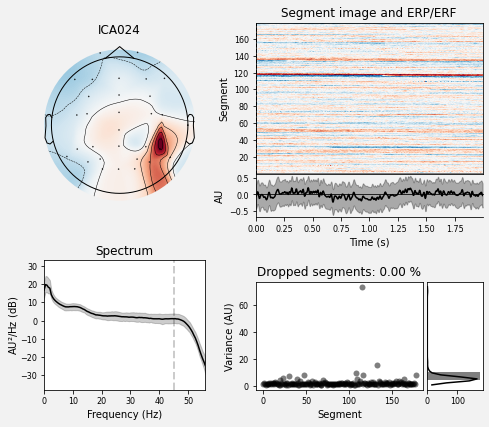

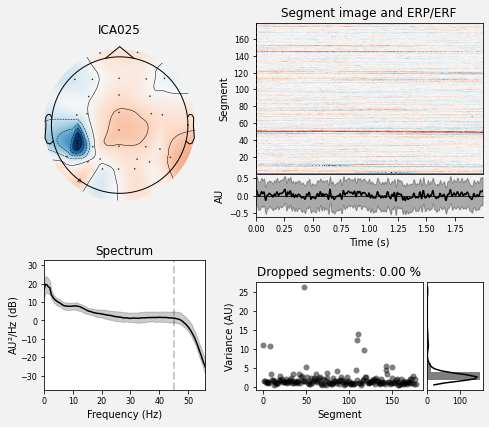

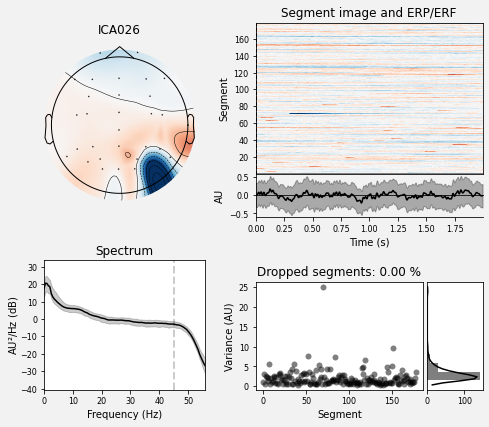

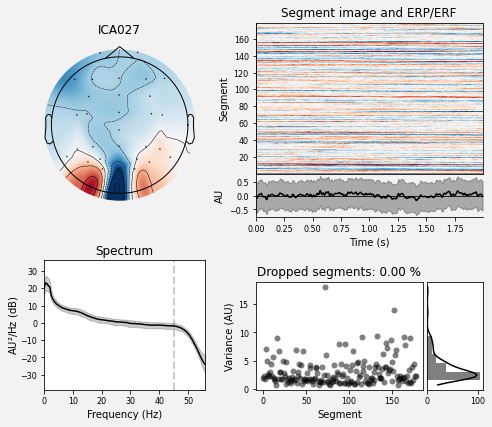

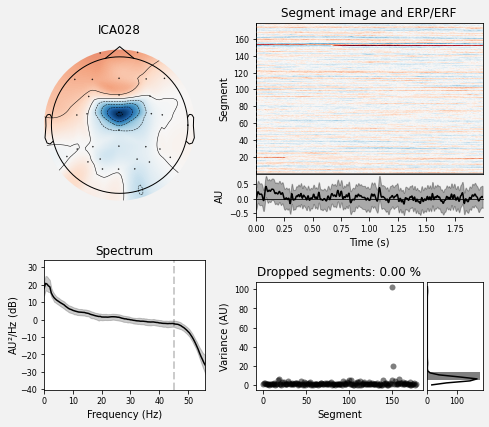

In [35]:
%matplotlib inline
# 1,4,10,11,21
exclude_heartbeat = []
exclude_blink = [0]
exclude_eye = [8,15,22]
exclude_muscle = [3,5,16,23,24,25,26]
exclude_noisy = [6,9,18,19,28]
questionable = [14,27]

to_exclude = []
to_exclude.extend(exclude_blink)
to_exclude.extend(exclude_eye)
to_exclude.extend(exclude_muscle)
to_exclude.extend(exclude_heartbeat)
to_exclude.extend(exclude_noisy)
print(to_exclude)

ica_two.plot_overlay(filtered_two_both, exclude=to_exclude, picks='eeg');

%matplotlib qt
ica_two.exclude = to_exclude
filtered_two_reconstructed = filtered_two_both.copy()
ica_two.apply(filtered_two_reconstructed)
filtered_two_reconstructed.plot();

%matplotlib inline
excluded = ica_two.plot_properties(filtered_two_both, picks = list(range(0,29)), show=False);

time = datetime.datetime.now().strftime('%m%d-%H%M')
for i, ex in enumerate(excluded):
    if i not in to_exclude:
        continue
    kind = ''
    if i in exclude_heartbeat:
        kind = 'heartbeat'
    elif i in exclude_blink:
        kind = 'blink'
    elif i in exclude_eye:
        kind = 'eye'
    elif i in exclude_muscle:
        kind = 'muscle'
    elif i in exclude_noisy:
        kind = 'noisy_electrode'
    elif i in questionable:
        kind = 'other'
    else:
        print(f"This should not happen! {to_exclude[i]}")
    
    path_ = Path(configuration.path_ica_results /
                 f"ICA_{configuration.participants[1]}_ICA0{i}_{kind}_{time}.png")
    ex.savefig(fname=str(path_),
               transparent=True);

Most of the oscillations are now excluded

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 845 samples (3.301 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.1s finished


Selecting by non-zero PCA components: 29 components
Fitting ICA took 191.0s.


/home/work/Dokumente/Studium/SimTech_MSc/14. Semester/Signal_Processing_and_Analysis_of_Human_Brain_Potentials_EEG/Ostertag_SS2022_EEGSemesterProject/venv/lib/python3.8/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


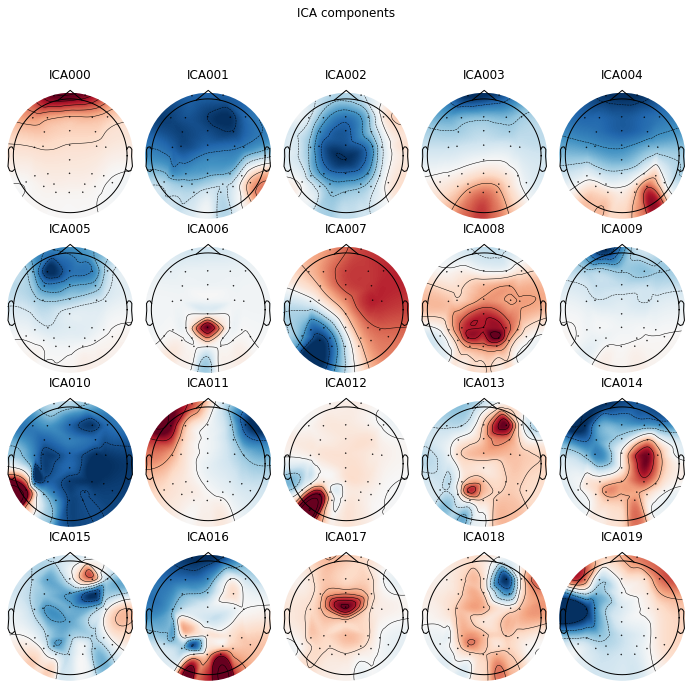

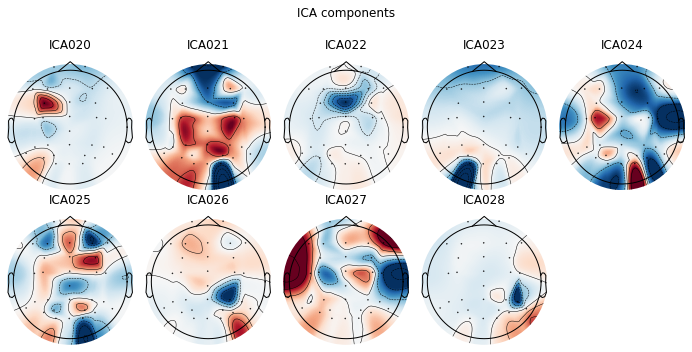

/home/work/Dokumente/Studium/SimTech_MSc/14. Semester/Signal_Processing_and_Analysis_of_Human_Brain_Potentials_EEG/Ostertag_SS2022_EEGSemesterProject/venv/lib/python3.8/site-packages/mne/viz/ica.py:128: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize, facecolor=[0.95] * 3)


[<Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6 Axes>,
 <Figure size 504x432 with 6

In [36]:
# subject three
ica_three = mne.preprocessing.ICA(method="fastica",
                                max_iter="auto",
                                random_state=configuration.seed_ICA)
filtered_three_ica = filtered_three_both.copy().filter(l_freq=1,
                                                   h_freq=None,
                                                   fir_design='firwin',
                                                   verbose=True)
ica_three.fit(filtered_three_ica, verbose=True)

%matplotlib inline
components = ica_three.plot_components(show=False)
for i, component in enumerate(components):
    # to change participant
    path_ = Path(configuration.path_ica_results /
                 f"ICA_{configuration.participants[2]}_{i}_{datetime.datetime.now().strftime('%m%d-%H%M')}.png")
    component.savefig(fname=str(path_),
                      transparent=True)
plt.show()

%matplotlib qt
ica_three.plot_properties(filtered_three_both, picks = list(range(0,29)))

[0, 9, 14, 2, 16, 18, 19, 21, 23, 6, 12, 17, 20, 22]


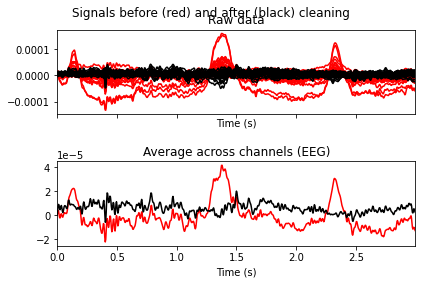

/home/work/Dokumente/Studium/SimTech_MSc/14. Semester/Signal_Processing_and_Analysis_of_Human_Brain_Potentials_EEG/Ostertag_SS2022_EEGSemesterProject/venv/lib/python3.8/site-packages/mne/viz/ica.py:128: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize, facecolor=[0.95] * 3)


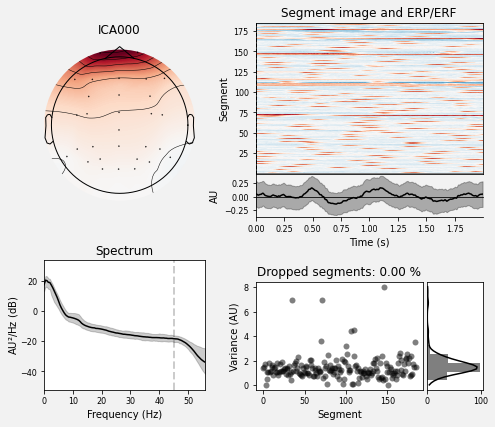

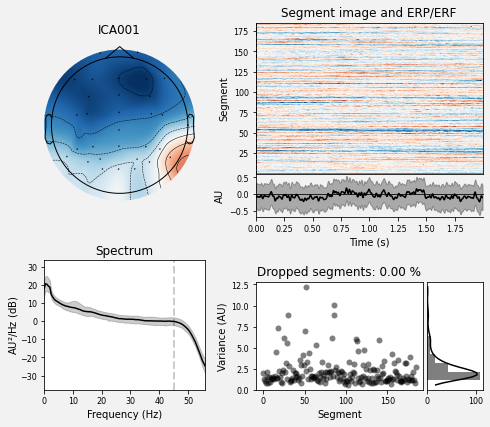

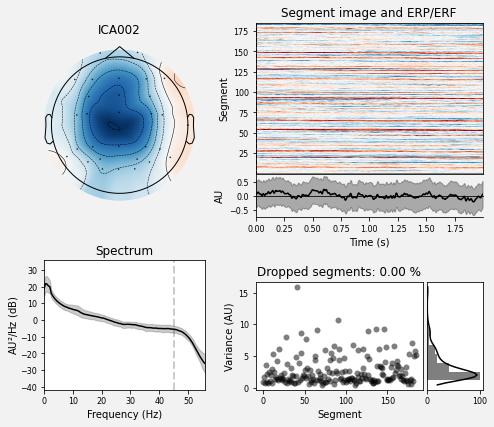

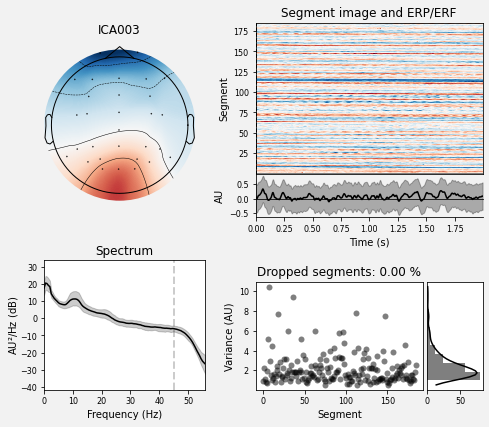

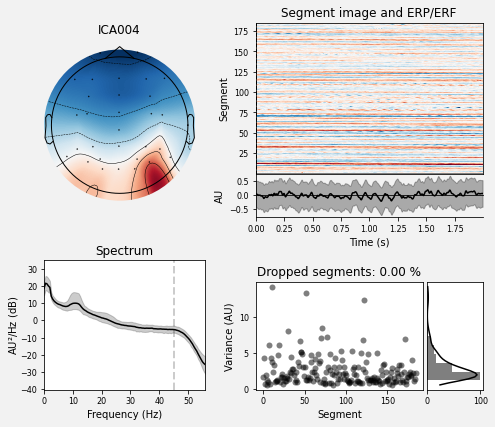

...

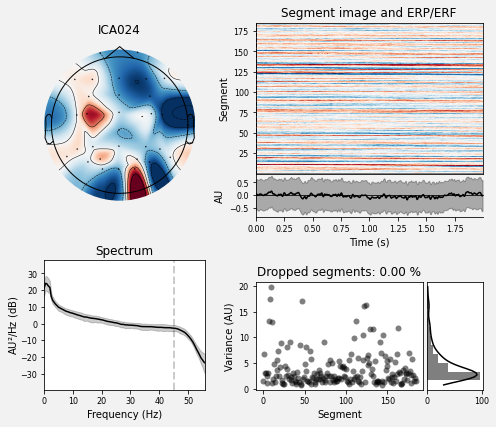

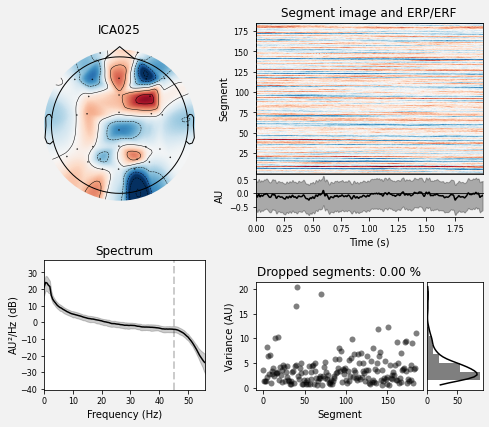

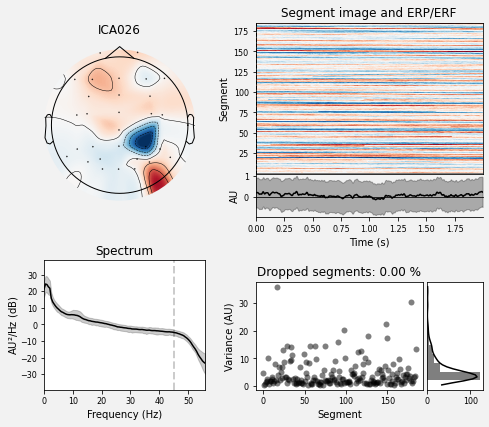

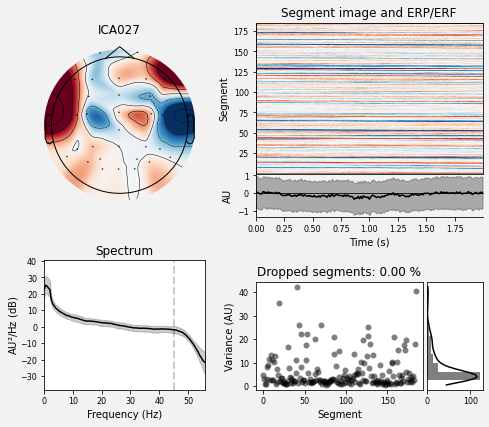

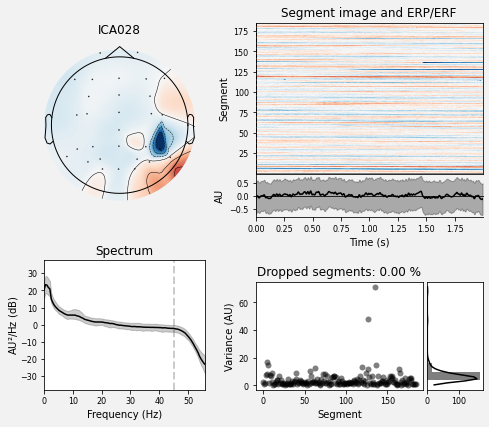

In [37]:
%matplotlib inline
# nice: 1,3,7,8,9
exclude_heartbeat = []
exclude_blink = [0]
exclude_eye = [9,14]
exclude_muscle = [2,16,18,19,21,23]
exclude_noisy = [6,12,17,20,22]
questionable = [14,24,25,26,27,28,29]

to_exclude = []
to_exclude.extend(exclude_blink)
to_exclude.extend(exclude_eye)
to_exclude.extend(exclude_muscle)
to_exclude.extend(exclude_heartbeat)
to_exclude.extend(exclude_noisy)
print(to_exclude)

ica_three.plot_overlay(filtered_three_both, exclude=to_exclude, picks='eeg');

%matplotlib qt
ica_three.exclude = to_exclude
filtered_three_reconstructed = filtered_three_both.copy()
ica_three.apply(filtered_three_reconstructed)
filtered_three_reconstructed.plot();

%matplotlib inline
excluded = ica_three.plot_properties(filtered_three_both, picks = list(range(0,29)), show=False);

time = datetime.datetime.now().strftime('%m%d-%H%M')
for i, ex in enumerate(excluded):
    if i not in to_exclude:
        continue
    kind = ''
    if i in exclude_heartbeat:
        kind = 'heartbeat'
    elif i in exclude_blink:
        kind = 'blink'
    elif i in exclude_eye:
        kind = 'eye'
    elif i in exclude_muscle:
        kind = 'muscle'
    elif i in exclude_noisy:
        kind = 'noisy_electrode'
    elif i in questionable:
        kind = 'other'
    else:
        print(f"This should not happen! {to_exclude[i]}")
    
    path_ = Path(configuration.path_ica_results /
                 f"ICA_{configuration.participants[2]}_ICA0{i}_{kind}_{time}.png")
    ex.savefig(fname=str(path_),
               transparent=True);

Some pretty strong ICA comp seem to have to be excluded here too, but for the second uptick the downtick is not removed.

## Data cleaning

### Trials with wrong response

In [38]:
wrong_trials = np.where(filtered_one_reconstructed.annotations.description == 'response:202')
for idx in wrong_trials:
    filtered_one_reconstructed.annotations.append(onset=filtered_one_reconstructed.annotations[idx].onset,
                                                 duration=filtered_one_reconstructed.annotations[idx].duration,
                                                 description='bad-response')

wrong_trials = np.where(filtered_two_reconstructed.annotations.description == 'response:202')
for idx in wrong_trials:
    filtered_two_reconstructed.annotations.append(onset=filtered_two_reconstructed.annotations[idx].onset,
                                                 duration=filtered_two_reconstructed.annotations[idx].duration,
                                                 description='bad-response')

wrong_trials = np.where(filtered_three_reconstructed.annotations.description == 'response:202')
for idx in wrong_trials:
    filtered_three_reconstructed.annotations.append(onset=filtered_three_reconstructed.annotations[idx].onset,
                                                    duration=filtered_three_reconstructed.annotations[idx].duration,
                                                    description='bad-response')

## Cleaning in time

I perform a manual cleaning in time:

In [39]:
%matplotlib qt
fig = filtered_one_reconstructed.plot()
fig.canvas.key_press_event('a')
filtered_one_reconstructed.annotations

<Annotations | 406 segments: bad-response (6), response:201 (194), ...>

I am pretty satisfied with the cleanness of the signal here. No large drifts or other artifacts.

In [40]:
%matplotlib qt
fig = filtered_two_reconstructed.plot()
fig.canvas.key_press_event('a')
filtered_two_reconstructed.annotations

<Annotations | 409 segments: bad-response (7), response:201 (195), ...>

In [44]:
%matplotlib qt
fig = filtered_three_reconstructed.plot()
fig.canvas.key_press_event('a')
filtered_three_reconstructed.annotations

<Annotations | 420 segments: BAD_ (7), BAD_aaaaa (1), bad-response (10), ...>

For most of the subjects I had only to mark some channels as bad, but for participant 32 I had to apply a stronger approach, marking large parts of the signal as bad.

I reviewed the channels, for the three subjects no channel seemed to be corrupted.

So I can go forward to save the annotations as they are:

In [43]:
# subject 1
file_name = f"{configuration.participants[0]}_{datetime.datetime.now().strftime('%m%d-%H%M')}_custom-annot.fif"
filtered_one_reconstructed.annotations.save(
    Path(configuration.path_annotation_results / file_name))

# subject 2
file_name = f"{configuration.participants[1]}_{datetime.datetime.now().strftime('%m%d-%H%M')}_custom-annot.fif"
filtered_two_reconstructed.annotations.save(
    Path(configuration.path_annotation_results / file_name))

# subject 3
file_name = f"{configuration.participants[2]}_{datetime.datetime.now().strftime('%m%d-%H%M')}_custom-annot.fif"
filtered_three_reconstructed.annotations.save(
    Path(configuration.path_annotation_results / file_name))

## Re-Referencing

Kappenman et al. (2021) re-referenced the signal to the average of `P9` and `P10`.

In [45]:
filtered_one_reconstructed.set_eeg_reference(ref_channels=['P9', 'P10'])
filtered_two_reconstructed.set_eeg_reference(ref_channels=['P9', 'P10'])
filtered_three_reconstructed.set_eeg_reference(ref_channels=['P9', 'P10'])

<RawEEGLAB | sub-032_ses-P3_task-P3_eeg.fdt, 33 x 94720 (370.0 s), ~23.9 MB, data loaded>